In [1]:
%load_ext autoreload
%autoreload 2

In [30]:
import pandas as pd
import numpy as np

from scipy.signal import find_peaks
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans


import matplotlib.pyplot as plt


from helpers import read_data
from helpers import select_data_interval
from helpers import get_entry_points
from helpers import get_peaks
from helpers import get_strokes
from helpers import get_exit_and_air_points
from helpers import indicators_calculator
from helpers import strokes_indicators
from helpers import delete_points_before_first_entry

from bokeh.plotting import figure
# Make Bokeh Push push output to Jupyter Notebook.
from bokeh.io import push_notebook, show, output_notebook
from bokeh.resources import INLINE
from bokeh.models import LinearAxis, Range1d


from bokeh.transform import factor_cmap



output_notebook()

plt.style.use(['science', 'notebook', 'grid'])

Loading BokehJS ...

In [3]:
all_data = read_data("data/serie1.csv")

In [4]:
data = select_data_interval(all_data, start=262.3, end=262.7)
entry = get_entry_points(all_data)
peaks = get_peaks(all_data)
exits, air_fase = get_exit_and_air_points(all_data)
plt.figure(figsize=(20, 6))
#plt.scatter(entry['time'], entry.ax, label=r'Entry', color='red', lw=3)
plt.plot(data['time'], data.ax, label=r'Acceleration in x direction')
plt.xlabel('time (s)')
plt.ylabel(r'Acceleration (m/s²)')
plt.legend()
plt.show()

IndexError: index 0 is out of bounds for axis 0 with size 0

In [5]:
data = select_data_interval(all_data, start=260, end=302)
entries = get_entry_points(data)
peaks = get_peaks(data)
exits, air_fase = get_exit_and_air_points(data)
strokes = get_strokes(data)

strokes, entries, peaks, exits, air_fase = delete_points_before_first_entry(
        strokes, entries, peaks, exits, air_fase)

p = figure(title="AccZ", x_axis_label='time', y_axis_label='Acceleration', height = 200)

# Add a line renderer with legend and line thickness
p.line(data.time,data.ax, legend="AccZ", color='red')
p.circle(entries.time, entries.ax, legend='Entry', color='green')
p.circle(peaks.time, peaks.ax, legend='Peaks', color='black')
p.circle(exits.time, exits.ax, legend='Exit', color='violet')
p.circle(air_fase.time, air_fase.ax, legend='air_fase', color='orange')
p.legend.click_policy="hide"
p.sizing_mode = "scale_width"
# Show the results
show(p)

AAA


In [6]:
peaks = get_peaks(data)
exits, air_fase = get_exit_and_air_points(data)
strokes = get_strokes(data)
print(f"Peaks: {len(peaks)}")
print(f"exits: {len(exits)}")
print(f"air_fase: {len(air_fase)}")
print(f"strokes: {len(strokes)}")

AAA
Peaks: 76
exits: 76
air_fase: 76
strokes: 76


In [7]:
data = select_data_interval(all_data, start=260, end=302)
indicatos = strokes_indicators(data)
indicatos

AAA


,Speed Variation - Entry Fase,Pitch Amplitude - Entry Fase,Mean Acceleration - Entry Fase,Mean Pitch - Entry Fase,Speed Variation - Pull Fase,Pitch Amplitude - Pull Fase,Mean Acceleration - Pull Fase,Mean Pitch - Pull Fase,Speed Variation - Exit Fase,Pitch Amplitude - Exit Fase,...,Mean Acceleration - Air Fase,Mean Pitch - Air Fase,Speed Variation - Water Fase,Pitch Amplitude - Water Fase,Mean Acceleration - Water Fase,Mean Pitch - Water Fase,Water Time,Air Time,Stroke Rate,Stroke Time
0,0.109638,0.344256,0.648852,1.985458,0.432427,0.370791,2.682119,2.432752,-0.019885,0.016482,...,-1.003503,2.277210,0.522180,0.731530,1.246971,2.239320,0.402049,0.408058,74.064263,0.810107
1,0.224824,0.273303,1.985621,1.735663,0.311760,0.529819,2.313523,2.206873,-0.048411,0.103758,...,-1.305281,2.352079,0.488173,0.906880,1.518954,2.083011,0.312043,0.348053,90.895951,0.660095
2,0.091460,0.125908,0.676796,1.872138,0.503761,0.740397,2.649657,2.275946,-0.005781,0.055893,...,-1.320991,2.452335,0.589440,0.893244,1.525506,2.127235,0.372054,0.360054,81.955176,0.732108
3,0.203782,0.138003,1.940720,1.587328,0.529660,1.003289,2.974101,2.028152,-0.037075,0.125348,...,-1.949335,2.709251,0.696366,1.163601,2.131980,1.951072,0.312045,0.276045,102.025195,0.588090
4,0.100290,0.446861,0.945662,2.049317,0.702076,0.947195,2.981527,2.059073,-0.003170,0.057772,...,-2.249570,3.026132,0.799196,1.004967,2.106056,2.080886,0.360048,0.210030,105.248886,0.570077
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
70,-0.011389,0.751768,0.179663,2.694623,0.374765,0.382595,2.980753,1.992709,-0.008112,0.020870,...,-1.146745,2.613952,0.355265,1.134363,1.187772,2.378967,0.288036,0.318048,98.996042,0.606085
71,0.123664,0.762854,1.180698,2.401101,0.276086,0.282650,1.792023,1.810908,-0.027204,0.080411,...,-1.439583,2.656631,0.372546,1.045504,1.224379,2.063632,0.294036,0.276041,105.248916,0.570077
72,0.213423,0.901954,1.376126,2.406665,0.045649,0.822103,0.251924,2.107923,-0.016153,0.051276,...,-1.775584,2.751620,0.242919,1.040816,0.521814,2.249667,0.444064,0.138031,103.075989,0.582095
73,0.152313,0.593019,1.037430,2.330380,0.115558,0.731638,0.588850,1.970295,-0.039418,0.150243,...,-1.577689,2.792764,0.228453,0.881880,0.472630,2.117718,0.432057,0.138024,105.248103,0.570082


In [8]:
#indicatos[indicatos.isna().any(axis=0)]
indicatos.isna().any(axis=0)

Speed Variation - Entry Fase      False
Pitch Amplitude - Entry Fase      False
Mean Acceleration - Entry Fase    False
Mean Pitch - Entry Fase           False
Speed Variation - Pull Fase       False
Pitch Amplitude - Pull Fase       False
Mean Acceleration - Pull Fase     False
Mean Pitch - Pull Fase            False
Speed Variation - Exit Fase       False
Pitch Amplitude - Exit Fase       False
Mean Acceleration - Exit Fase     False
Mean Pitch - Exit Fase            False
Speed Variation - Air Fase        False
Pitch Amplitude - Air Fase        False
Mean Acceleration - Air Fase      False
Mean Pitch - Air Fase             False
Speed Variation - Water Fase      False
Pitch Amplitude - Water Fase      False
Mean Acceleration - Water Fase    False
Mean Pitch - Water Fase           False
Water Time                        False
Air Time                          False
Stroke Rate                       False
Stroke Time                       False
dtype: bool

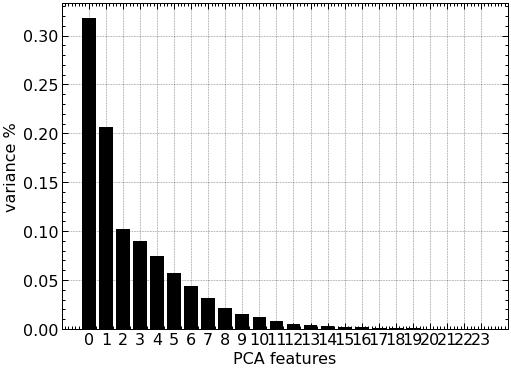

In [9]:
# Standardize the data to have a mean of ~0 and a variance of 1
X_std = StandardScaler().fit_transform(indicatos)# Create a PCA instance: pca
pca = PCA(n_components=24)
principalComponents = pca.fit_transform(X_std)# Plot the explained variances
features = range(pca.n_components_)
plt.bar(features, pca.explained_variance_ratio_, color='black')
plt.xlabel('PCA features')
plt.ylabel('variance %')
plt.xticks(features)# Save components to a DataFrame
PCA_components = pd.DataFrame(principalComponents)

Text(0, 0.5, 'PCA 2')

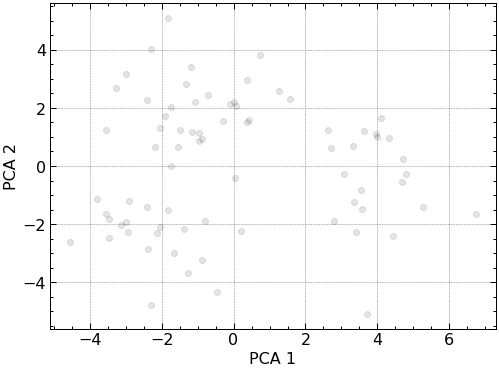

In [10]:
plt.scatter(PCA_components[0], PCA_components[1], alpha=.1, color='black')
plt.xlabel('PCA 1')
plt.ylabel('PCA 2')

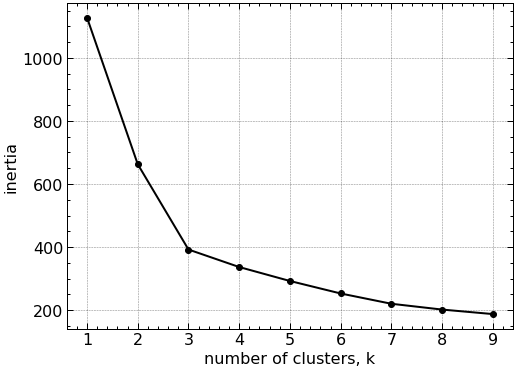

In [11]:
ks = range(1, 10)
inertias = []
for k in ks:
    # Create a KMeans instance with k clusters: model
    model = KMeans(n_clusters=k)
    
    # Fit model to samples
    model.fit(PCA_components.iloc[:,:3])
    
    # Append the inertia to the list of inertias
    inertias.append(model.inertia_)
    
plt.plot(ks, inertias, '-o', color='black')
plt.xlabel('number of clusters, k')
plt.ylabel('inertia')
plt.xticks(ks)
plt.show()

In [12]:
kmeans = KMeans(
    init="random",
    n_clusters=3,
    n_init=10,
    max_iter=300,
    random_state=42
)

kmeans.fit(PCA_components)


KMeans(init='random', n_clusters=3, random_state=42)

In [13]:
kmeans.labels_

array([0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 1, 1, 1, 1, 1, 2, 1,
       1, 1, 1, 1, 1, 1, 1, 2, 2, 0, 2, 0, 2, 0, 0, 0, 0, 2, 2, 0, 0, 2,
       2, 0, 0, 0, 0, 2, 2, 0, 2, 0, 2, 0, 0, 2, 2, 0, 2, 0, 0, 0, 2, 0,
       0, 0, 0, 0, 0, 0, 2, 2, 2], dtype=int32)

In [33]:
indicatos['Cluster Label'] = kmeans.labels_

In [32]:
#data['Label'] = ['-' for i in range(len(data))]
label_data =  data.copy()
label_data = label_data.drop(index=label_data.index)

for stroke, label in zip(strokes, kmeans.labels_):
    mask = (data.time >= stroke.time.iloc[0]) &  (data.time >= stroke.time.iloc[-1])
    aux = data[mask].copy()#.loc[:,['Label']] = label
    aux['label'] = [str(label )for i in range(len(aux))]
    label_data = pd.concat([label_data, aux])
    label_data = label_data.sort_values(by='time', ascending=True)
    label_data = label_data.reset_index(drop=True)

In [17]:
def set_color(val):
    if val = 0:
        return 

,gx,gy,gz,ax,ay,az,roll,pitch,yaw,time_stamp,VideoRecord,DataRecord,time,label
0,-0.342063,1.029043,9.719865,-1.452458,-0.127681,-0.641594,6.043397,2.004342,-129.022109,2021-04-14 09:40:44.194066136,0,0,260.395263,0.0
1,-0.338933,1.040123,9.718794,-1.528686,-0.150501,-0.566648,6.108649,1.985990,-129.014706,2021-04-14 09:40:44.200073097,0,0,260.401270,0.0
2,-0.336206,1.053694,9.717423,-1.463193,-0.113487,-0.611429,6.188598,1.970008,-129.006550,2021-04-14 09:40:44.212072259,0,0,260.413269,0.0
3,-0.334171,1.069594,9.715760,-1.391737,-0.066566,-0.193189,6.282312,1.958076,-128.997466,2021-04-14 09:40:44.224074088,0,0,260.425271,0.0
4,-0.332921,1.088292,9.713727,-1.293643,0.219766,-0.389084,6.392564,1.950752,-128.987194,2021-04-14 09:40:44.230076771,0,0,260.431273,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
160621,-0.307844,-0.783889,9.743838,-0.337599,-2.277367,1.116586,-4.599522,1.803758,-128.837148,2021-04-14 09:41:25.792047917,0,0,301.993244,1.0
160622,-0.307844,-0.783889,9.743838,-0.337599,-2.277367,1.116586,-4.599522,1.803758,-128.837148,2021-04-14 09:41:25.792047917,0,0,301.993244,1.0
160623,-0.307844,-0.783889,9.743838,-0.337599,-2.277367,1.116586,-4.599522,1.803758,-128.837148,2021-04-14 09:41:25.792047917,0,0,301.993244,1.0
160624,-0.307844,-0.783889,9.743838,-0.337599,-2.277367,1.116586,-4.599522,1.803758,-128.837148,2021-04-14 09:41:25.792047917,0,0,301.993244,0.0


In [43]:


index_cmap = factor_cmap('label', palette=['red', 'green', 'blue'], 
                         factors=sorted(label_data.label.unique()))




# p = figure(title="AccZ", x_axis_label='time', y_axis_label='Acceleration', height = 200)

# Add a line renderer with legend and line thickness
# p.line(data.time,data.ax, legend="AccZ", color='red')
# p.circle(entries.time, entries.ax, legend='Entry', color='green')
# p.circle(peaks.time, peaks.ax, legend='Peaks', color='black')
# p.circle(exits.time, exits.ax, legend='Exit', color='violet')
# p.circle(air_fase.time, air_fase.ax, legend='air_fase', color='orange')
# p.legend.click_policy="hide"
# p.sizing_mode = "scale_width"
# Show the results

p = figure(height = 400, width=800, title = "Decathlon: Discus x Javeline")
p.scatter('time','ax',source=label_data, fill_color=index_cmap,legend='AccX')
p.xaxis.axis_label = 'Time'
p.yaxis.axis_label = 'ax'
p.legend.location = "top_left"

show(p)

In [44]:
label_data.label

0         0
1         0
2         0
3         0
4         0
         ..
160621    1
160622    1
160623    1
160624    0
160625    2
Name: label, Length: 160626, dtype: object

In [47]:
len(strokes[1:])

75

In [46]:
len(kmeans.labels_)

75

In [48]:
for stroke, label in zip(strokes[1:], kmeans.labels_):
    stroke['label'] = [label for _ in range(len(stroke))]
    

In [56]:
p = figure(title="AccZ", x_axis_label='time', y_axis_label='Acceleration', height = 200)

# Add a line renderer with legend and line thickness
p.line(data.time,data.ax, legend="AccZ", color='black')
for stroke in strokes[1:]:
    if stroke.label.iloc[0] == 0:
        color = 'red'
    elif stroke.label.iloc[0] == 1:
        color = 'green'
    elif stroke.label.iloc[0] == 2:
        color = 'orange'
        
    p.circle(stroke.time, stroke.ax, color=color)
p.legend.click_policy="hide"
p.sizing_mode = "scale_width"
# Show the results
show(p)

In [54]:
stroke.label

0     0
1     0
2     0
3     0
4     0
     ..
77    0
78    0
79    0
80    0
81    0
Name: label, Length: 82, dtype: int64